**Important**

The main notebook is in the `notebook_answers.ipynb` file. That notebook refers to this one as an exploration into improving model performance on a subset of images. Please read that notebook before inspecting this one in order for it to make sense.

**Imports**

In [1]:
import jupyter_black

jupyter_black.load(lab=False)

import copy
import os
from collections import defaultdict
from operator import itemgetter

import cv2
import matplotlib.pyplot as plt
import numpy as np
import torch
import torch.nn as nn
from patchify import patchify, unpatchify
from sklearn.model_selection import train_test_split
from torch.utils.data import DataLoader, Dataset
from torchvision import transforms
from tqdm import tqdm

<IPython.core.display.Javascript object>

**Set up global variables**

In [2]:
# Folder containing data
DATA_PATH = "data"
PATCH_DIM = (
    64,
    64,
    3,
)  # Dimensions of patch size; try first with keeping the colour channels
BATCH_SIZE = 32

**Load data, separating into patches**

In [3]:
# Get image paths
img_fpaths = [
    os.path.join(DATA_PATH, f) for f in os.listdir(DATA_PATH) if f.endswith(".jpg")
]
# Sub-select
img_fpaths = img_fpaths[:3] + [img_fpaths[4]]

# Save patches in a dictionary
img_patch_dict = {}
for fpath in img_fpaths:
    # Load image as an array
    img = np.array(cv2.imread(fpath))

    # Resize image so it can be divided into patches
    img_dim = [(img.shape[i] // PATCH_DIM[i]) * PATCH_DIM[i] for i in (1, 0)]
    img = cv2.resize(img, img_dim)

    # Use patchify library to split into patches that can be re-assembled if needed
    patches = patchify(img, PATCH_DIM, step=PATCH_DIM[0])

    # Re-arrange patches into list that can later be interpreted by data loader
    img_patches = []
    for h in range(patches.shape[0]):
        for w in range(patches.shape[1]):
            img_patches.append(patches[h, w, 0])

    # Place in dictionary
    img_patch_dict[fpath] = img_patches

for k, v in img_patch_dict.items():
    print(f"{len(v)} patches created for image file {k}")

1200 patches created for image file data/2021-04-07 21_37_18_exai_rpi_001_58.jpg
1200 patches created for image file data/2021-04-07 21_45_00_exai_rpi_004_176.jpg
1200 patches created for image file data/2021-04-07 21_36_40_exai_rpi_004_51.jpg
1200 patches created for image file data/2021-04-07 21_39_20_exai_rpi_004_91.jpg


**Create train/val/test split**

We'll be building our model in torch, so make a torch-friendly loader.

In [4]:
# Custom Dataset class interpretable by torch dataloader
class WoodDataset(Dataset):
    def __init__(self, data, transform):
        self.data = data
        self.transform = transform

    def __getitem__(self, index):
        x = self.data[index]
        return self.transform(x)

    def __len__(self):
        return len(self.data)


# Define transform
transform = transforms.Compose([transforms.ToTensor()])

# Make dataset
dataset = WoodDataset(
    data=[x for i in itemgetter(*img_fpaths)(img_patch_dict) for x in i],
    transform=transform,
)

# Make dataloader - iterative class that feeds images into the model during training
dataloader = DataLoader(
    dataset,
    batch_size=BATCH_SIZE,
    shuffle=True,
)

**Build autoencoder model**

In [5]:
class Autoencoder(nn.Module):
    def __init__(self):
        super(Autoencoder, self).__init__()
        # Encoder:
        self.conv1 = nn.Conv2d(3, 16, 3, padding=1)
        self.conv2 = nn.Conv2d(16, 4, 3, padding=1)

        # Pooling:
        self.pool = nn.MaxPool2d(2, 2)

        # Decoder:
        self.t_conv1 = nn.ConvTranspose2d(4, 16, 2, stride=2)
        self.t_conv2 = nn.ConvTranspose2d(16, 3, 2, stride=2)

    def forward(self, x):
        # Encoder
        x = nn.functional.relu(self.conv1(x))
        x = self.pool(x)
        x = nn.functional.relu(self.conv2(x))

        # Low-D representation:
        x = self.pool(x)

        # Decoder
        x = nn.functional.relu(self.t_conv1(x))
        x = torch.sigmoid(self.t_conv2(x))

        return x


# Instantiate the model
model = Autoencoder()
print(model)

Autoencoder(
  (conv1): Conv2d(3, 16, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (conv2): Conv2d(16, 4, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (pool): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (t_conv1): ConvTranspose2d(4, 16, kernel_size=(2, 2), stride=(2, 2))
  (t_conv2): ConvTranspose2d(16, 3, kernel_size=(2, 2), stride=(2, 2))
)


**Define training configs**

In [6]:
# Define loss function
loss_fn = nn.MSELoss()

# Define optimizer
optim = torch.optim.Adam(model.parameters(), lr=0.001)

**Train the model on the training data**

In [7]:
# Set number of epochs for training
n_epochs = 100

for epoch in tqdm(range(n_epochs)):
    # Initialise training loss
    train_loss = 0.0

    for data in dataloader:
        # Set tensor gradients to zero
        optim.zero_grad()

        # Compute predicted outputs
        outputs = model(data)

        # Get loss
        loss = loss_fn(outputs, data)

        # Compute gradient wrt loss and network parameters
        loss.backward()

        # Parameter update
        optim.step()

        # Track loss
        train_loss += loss.item() * data.size(0)

    # Print average loss
    train_loss = train_loss / len(dataloader)

    if (epoch % 10 == 0) | (epoch == n_epochs - 1):
        print("Epoch: {} \tTraining Loss: {:.6f}".format(epoch, train_loss))

  1%|▍                                          | 1/100 [00:06<11:06,  6.73s/it]

Epoch: 0 	Training Loss: 0.948789


 11%|████▌                                     | 11/100 [01:11<09:36,  6.48s/it]

Epoch: 10 	Training Loss: 0.081773


 21%|████████▊                                 | 21/100 [02:16<08:33,  6.50s/it]

Epoch: 20 	Training Loss: 0.063410


 31%|█████████████                             | 31/100 [03:21<07:26,  6.48s/it]

Epoch: 30 	Training Loss: 0.058471


 41%|█████████████████▏                        | 41/100 [04:27<06:37,  6.74s/it]

Epoch: 40 	Training Loss: 0.056373


 51%|█████████████████████▍                    | 51/100 [05:32<05:17,  6.48s/it]

Epoch: 50 	Training Loss: 0.054853


 61%|█████████████████████████▌                | 61/100 [06:36<04:08,  6.36s/it]

Epoch: 60 	Training Loss: 0.052289


 71%|█████████████████████████████▊            | 71/100 [07:40<03:04,  6.35s/it]

Epoch: 70 	Training Loss: 0.047546


 81%|██████████████████████████████████        | 81/100 [08:38<01:40,  5.27s/it]

Epoch: 80 	Training Loss: 0.045373


 91%|██████████████████████████████████████▏   | 91/100 [09:28<00:44,  4.95s/it]

Epoch: 90 	Training Loss: 0.043123


100%|█████████████████████████████████████████| 100/100 [10:12<00:00,  6.13s/it]

Epoch: 99 	Training Loss: 0.042053


**Visualise the reconstruction performance on some validation patches**

Here we can see the extent to which the autoencoder is able to reconstruct an original patch based on its latent representation. We should see that the reconstructed image is quite similar to the original, which will tell us that training worked as expected.

I used these cells to manually fine-tune the reconstruction error threshold. 

In [8]:
def add_red_overlay(img, alpha=0.3):
    overlay = cv2.rectangle(copy.deepcopy(img), (0, 0), img.shape[:2], (200, 0, 0), -1)
    img_new = cv2.addWeighted(overlay, alpha, copy.deepcopy(img), 1 - alpha, 1)
    return img_new


def visualise_anomalies(
    image_to_patchify,
    patch_dim,
    model,
    reconstruction_error_threshold=0.002,
    loss_fn=nn.MSELoss(),
    transform=transforms.Compose([transforms.ToTensor()]),
):
    # Patchify
    patches = patchify(image_to_patchify, PATCH_DIM, step=PATCH_DIM[0])

    # Re-arrange patches into list that can later be interpreted by data loader
    for h in range(patches.shape[0]):
        for w in range(patches.shape[1]):
            # Extract desired patch
            input_patch = patches[h, w, 0]

            # Get reconstruction from model
            reconstruction = model(transform(input_patch))

            # Get reconstruction error
            reconstruction_error = loss_fn(reconstruction, transform(input_patch))

            # If error > threshold, overlay a red rectangle
            if reconstruction_error >= reconstruction_error_threshold:
                patch = patches[h, w, 0]
                patches[h, w, 0] = add_red_overlay(patch)

    return unpatchify(patches, image_to_patchify.shape)

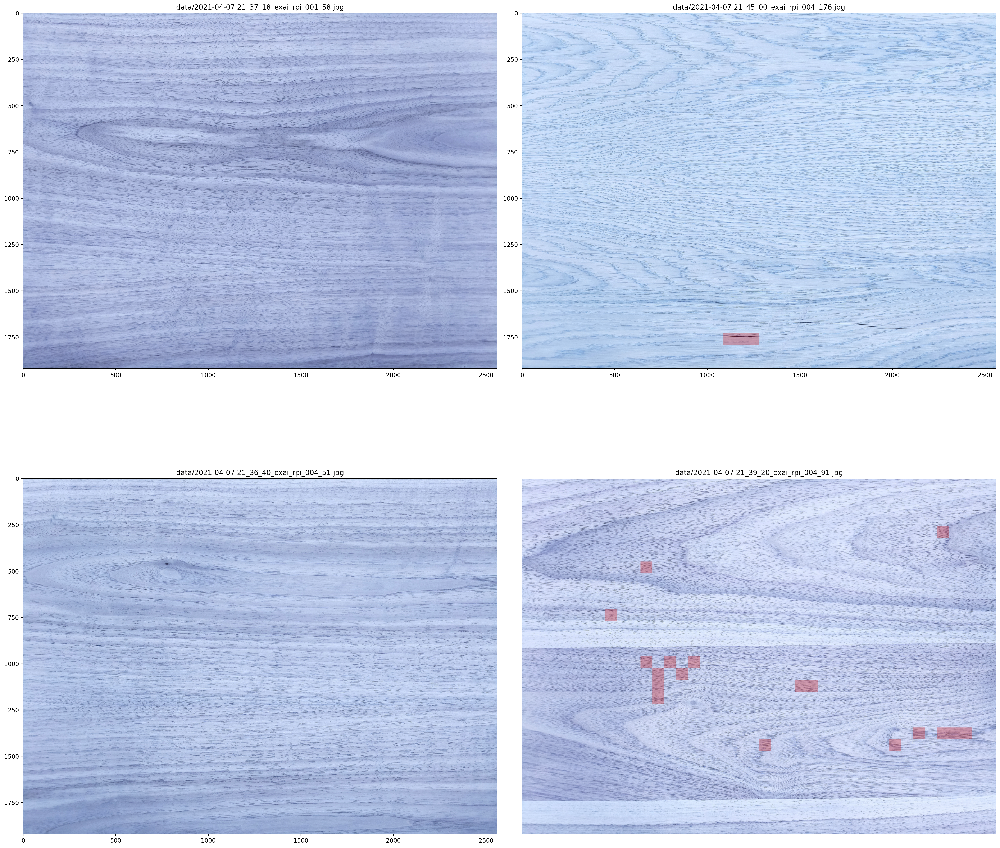

In [12]:
reconstruction_error_thresh = 0.005

f, ax = plt.subplots(2, 2, figsize=(24, 24))
ax = ax.ravel()

for ax_idx, path in enumerate(img_fpaths):
    # Load image as an array
    img = np.array(cv2.imread(path))

    # Resize image
    img_dim = [(img.shape[i] // PATCH_DIM[i]) * PATCH_DIM[i] for i in (1, 0)]
    img = cv2.resize(img, img_dim)

    img_ = visualise_anomalies(
        image_to_patchify=img,
        patch_dim=PATCH_DIM,
        model=model,
        reconstruction_error_threshold=reconstruction_error_thresh,
        loss_fn=loss_fn,
        transform=transform,
    )

    ax[ax_idx].imshow(img_)
    ax[ax_idx].set_title(path)

ax[-1].axis("off")
f.tight_layout()
f.set_dpi(200)